<a href="https://colab.research.google.com/github/andresperez86/Ejemplos-Clase-20212/blob/master/Fkinematics_using_DH_for_Fanuc_Arc_Mate_100i_robot_arm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget --no-cache -O serialrobot.py -q https://raw.githubusercontent.com/andresperez86/Ejemplos-Clase-20212/master/serialrobot.py

##Ejemplo 2: Denavit-Hartenberg Fanuc Arc Mate 100i robot arm.
##1. Symbolic Calculation of Direct Kinematics
Sympy will be used to find the homogeneous Denavit-Hartenberg transformation matrix (standard convention)

In [ ]:
from serialrobot import *

In [ ]:
import sympy as sp                # Biblioteca para el cálculo simbólico

def sTdh(d, th, a, alpha):
    cth = sp.cos(th); sth = sp.sin(th)
    ca = sp.cos(alpha); sa = sp.sin(alpha)
    Tdh = sp.Matrix([[cth, -ca*sth,  sa*sth, a*cth],
                     [sth,  ca*cth, -sa*cth, a*sth],
                     [0,        sa,     ca,      d],
                     [0,         0,      0,      1]])
    return Tdh

In [ ]:
# Variables simbólicas
q1, q2, q3, q4, q5, q6 = sp.symbols("q1 q2 q3 q4 q5 q6")
#l1, l2, l3, l4 = sp.symbols("l1 l2 l3 l4")

# Transformaciones homogéneas
T01 = sTdh( 450,   sp.pi+q1, -150, sp.pi/2)
T12 = sTdh(   0, q2+sp.pi/2,  600,       0)
T23 = sTdh(   0,   q3+sp.pi, -200, sp.pi/2)
T34 = sTdh( 640,   q4+sp.pi,    0, sp.pi/2)
T45 = sTdh(   0,   q5+sp.pi,    0, sp.pi/2)
T56 = sTdh(   0,         q6,    0,       0)

# Transformación homogénea final
Tf = sp.simplify(T01*T12*T23*T34*T45*T56)

# Mostrar las transformaciones homogéneas (display funciona con IPython)
print("T01:"); display(T01)
print("T12:"); display(T12)
print("T23:"); display(T23)
print("T34:"); display(T34)
print("T45:"); display(T45)
print("T56:"); display(T56)
print("T06:"); display(Tf)

T01:


Matrix([
[-cos(q1), 0, -sin(q1), 150*cos(q1)],
[-sin(q1), 0,  cos(q1), 150*sin(q1)],
[       0, 1,        0,         450],
[       0, 0,        0,           1]])

T12:


Matrix([
[-sin(q2), -cos(q2), 0, -600*sin(q2)],
[ cos(q2), -sin(q2), 0,  600*cos(q2)],
[       0,        0, 1,            0],
[       0,        0, 0,            1]])

T23:


Matrix([
[-cos(q3), 0, -sin(q3), 200*cos(q3)],
[-sin(q3), 0,  cos(q3), 200*sin(q3)],
[       0, 1,        0,           0],
[       0, 0,        0,           1]])

T34:


Matrix([
[-cos(q4), 0, -sin(q4),   0],
[-sin(q4), 0,  cos(q4),   0],
[       0, 1,        0, 640],
[       0, 0,        0,   1]])

T45:


Matrix([
[-cos(q5), 0, -sin(q5), 0],
[-sin(q5), 0,  cos(q5), 0],
[       0, 1,        0, 0],
[       0, 0,        0, 1]])

T56:


Matrix([
[cos(q6), -sin(q6), 0, 0],
[sin(q6),  cos(q6), 0, 0],
[      0,        0, 1, 0],
[      0,        0, 0, 1]])

T06:


Matrix([
[-((sin(q1)*sin(q4) + sin(q2 + q3)*cos(q1)*cos(q4))*cos(q5) + sin(q5)*cos(q1)*cos(q2 + q3))*cos(q6) - (sin(q1)*cos(q4) - sin(q4)*sin(q2 + q3)*cos(q1))*sin(q6), ((sin(q1)*sin(q4) + sin(q2 + q3)*cos(q1)*cos(q4))*cos(q5) + sin(q5)*cos(q1)*cos(q2 + q3))*sin(q6) + (-sin(q1)*cos(q4) + sin(q4)*sin(q2 + q3)*cos(q1))*cos(q6), -(sin(q1)*sin(q4) + sin(q2 + q3)*cos(q1)*cos(q4))*sin(q5) + cos(q1)*cos(q5)*cos(q2 + q3), 10*(60*sin(q2) + 20*sin(q2 + q3) + 64*cos(q2 + q3) + 15)*cos(q1)],
[((-sin(q1)*sin(q2 + q3)*cos(q4) + sin(q4)*cos(q1))*cos(q5) - sin(q1)*sin(q5)*cos(q2 + q3))*cos(q6) + (sin(q1)*sin(q4)*sin(q2 + q3) + cos(q1)*cos(q4))*sin(q6),  ((sin(q1)*sin(q2 + q3)*cos(q4) - sin(q4)*cos(q1))*cos(q5) + sin(q1)*sin(q5)*cos(q2 + q3))*sin(q6) + (sin(q1)*sin(q4)*sin(q2 + q3) + cos(q1)*cos(q4))*cos(q6), -(sin(q1)*sin(q2 + q3)*cos(q4) - sin(q4)*cos(q1))*sin(q5) + sin(q1)*cos(q5)*cos(q2 + q3), 10*(60*sin(q2) + 20*sin(q2 + q3) + 64*cos(q2 + q3) + 15)*sin(q1)],
[                                      

In [ ]:
# Valor cuando todos los ángulos son cero
print("T06 cuando q=(0,0,0,0,0,0):")
Tf.subs({q1:0., q2:0., q3:0., q4:0., q5:0., q6:0.})

T06 cuando q=(0,0,0,0,0,0):


Matrix([
[ 0, 0, 1,  790],
[ 0, 1, 0,    0],
[-1, 0, 0, 1250],
[ 0, 0, 0,    1]])

##2. Cálculo Numérico de la Cinemática Directa

En este caso se utilizará numpy para el manejo de matrices y vectores

In [ ]:
import numpy as np

def Tdh(d, th, a, alpha):
    cth = np.cos(th);    sth = np.sin(th)
    ca = np.cos(alpha);  sa = np.sin(alpha)
    Tdh = np.array([[cth, -ca*sth,  sa*sth, a*cth],
                    [sth,  ca*cth, -sa*cth, a*sth],
                    [0,        sa,     ca,      d],
                    [0,         0,      0,      1]])
    return Tdh

In [ ]:
# Cinemática directa del robot
def cdirecta_fanuc(q):
    """ Retorna los sistemas de referencia de cada eslabón con respecto a la base
    """
    # Transformaciones homogéneas de DH
    T01 = Tdh( 450,   np.pi+q[0], -150, np.pi/2);
    T12 = Tdh(   0, q[1]+np.pi/2,  600,       0);
    T23 = Tdh(   0,   q[2]+np.pi, -200, np.pi/2);
    T34 = Tdh( 640,   q[3]+np.pi,    0, np.pi/2);
    T45 = Tdh(   0,   q[4]+np.pi,    0, np.pi/2);
    T56 = Tdh(   0,         q[5],    0,       0);
    # Efector final con respecto a la base
    Tf = T01.dot(T12).dot(T23).dot(T34).dot(T45).dot(T56)
    return Tf

In [ ]:
# Ejemplo de cálculo de la cinemática directa
q = np.array([0., 0., 0., 0., 0., 0.])

# Cinemática directa
Te = cdirecta_fanuc(np.deg2rad(q))   # Cinemática directa

# Mostrar el resultado
print("End effector with respect to the base when q1={}, q2={}, q3={}, q4={}, q5={}, q6={}".format(q[0], q[1], q[2],
                                                                                                    q[3], q[4], q[5]))

print(np.round(Te,4))

NameError: name 'np' is not defined

##3. Plot Fanuc Arc Mate 100i robot arm
A class called SerialRobot will be used to define the robot using the calculated Denavit-Hartenberg parameters. The robot will be graphed using this class. Internally, this class uses matplotlib to create the graph.

In [ ]:
from serialrobot import *

In [ ]:
# Parámetros DH del robot
# d, th, a, alpha
L = [[ 0.450,   np.pi, -0.150, np.pi/2, 'r'],
     [     0, np.pi/2,  0.600,       0, 'r'],
     [     0,   np.pi, -0.200, np.pi/2, 'r'],
     [ 0.640,   np.pi,      0, np.pi/2, 'r'],
     [     0,   np.pi,      0, np.pi/2, 'r'],
     [     0,       0,      0,       0, 'r']]

# Creación del robot
fanuc = SerialRobot(L,name="Fanuc")

In [ ]:
# "qt" realiza el gráfico en una ventana nueva (para abrir un nuevo gráfico usar matplotlib qt)
%matplotlib inline

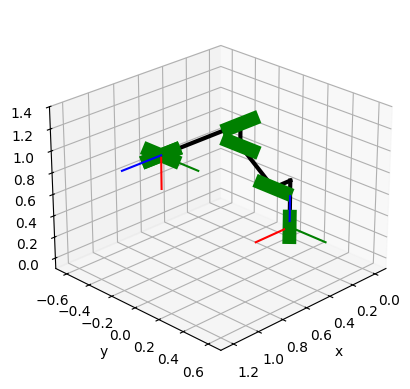

In [ ]:
alims = [[-0.1,1.3],[-0.7,0.7],[-0.1, 1.4]]
fanuc.plot([0, 0.5, -0.5, 0., -0, 0], axlimits=alims, ascale=0.3, ee=False)

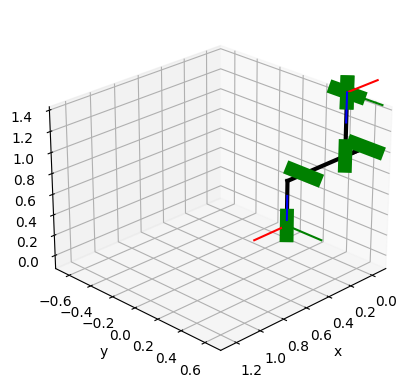

In [ ]:
alims = [[-0.1,1.3],[-0.7,0.7],[-0.1, 1.4]]
fanuc.plot([3.1416, 1.5708, 3.1416, 3.1416,3.1416, 0], axlimits=alims, ascale=0.3, ee=False)

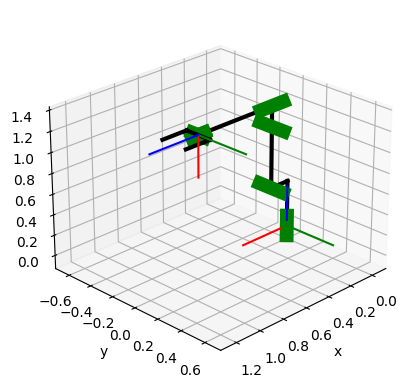

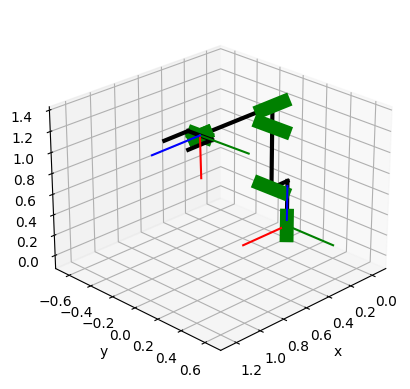

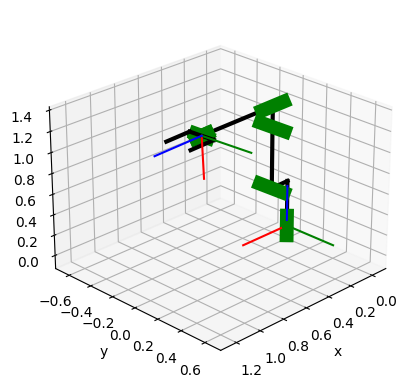

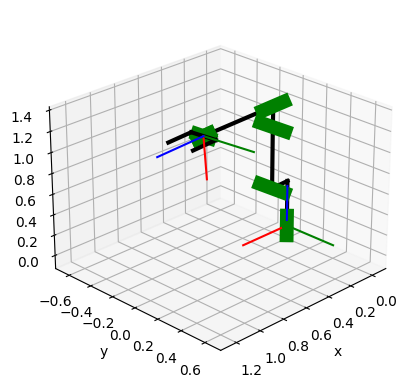

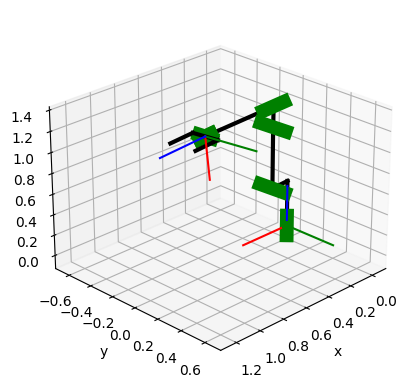

...

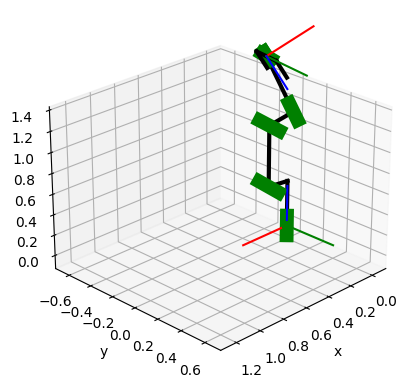

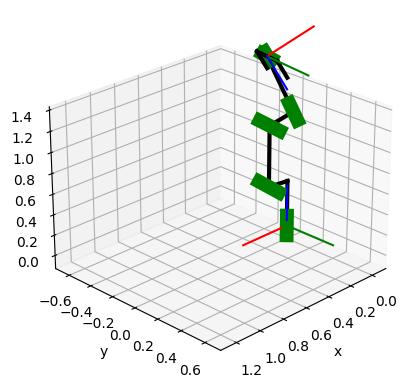

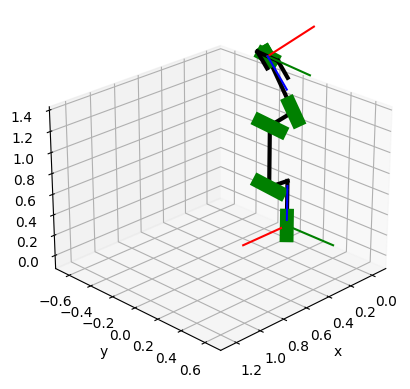

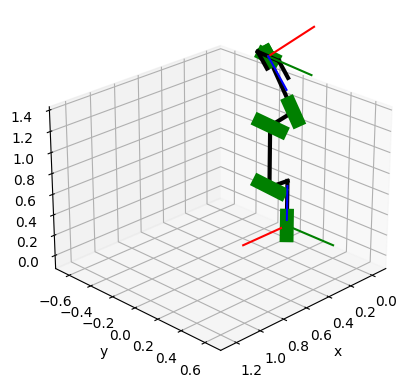

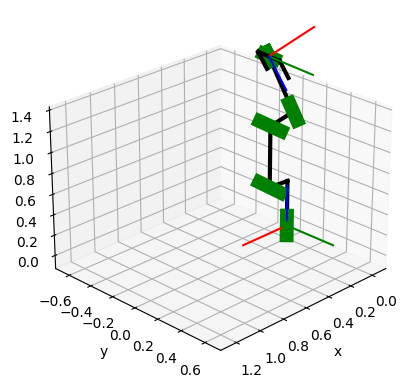

KeyboardInterrupt: ignored

In [ ]:
for i in range(360):
  q=[np.deg2rad(i), 0, -np.deg2rad(0.2*i), np.deg2rad(0.5*i), np.deg2rad(0.5*i), np.deg2rad(0.5*i) ]
  fanuc.plot(q,axlimits=alims)
  plt.pause(0.01)

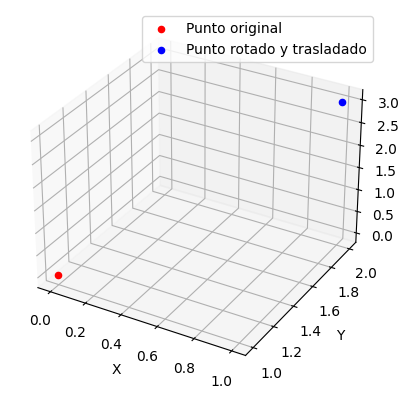

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Función para rotar un punto con un cuaternión
def rotate_point(point, quaternion):
    # Conjugado del cuaternión
    conjugate = np.array([quaternion[0], -quaternion[1], -quaternion[2], -quaternion[3]])

    # Aplicar la rotación
    rotated_point = quaternion * point * conjugate

    return rotated_point[1:4]  # Ignorar la parte escalar

# Punto original
point = np.array([0, 1, 0, 1])  # Coordenadas homogéneas (x, y, z, 1)

# Cuaternión de rotación (ejemplo: rotar 45 grados alrededor del eje y)
angle = np.pi / 4
axis = np.array([0, 1, 0])  # Eje y
quaternion = np.array([np.cos(angle/2), axis[0]*np.sin(angle/2), axis[1]*np.sin(angle/2), axis[2]*np.sin(angle/2)])

# Vector de traslación (ejemplo: trasladar 1 unidad en x, 2 unidades en y y 3 unidades en z)
translation = np.array([1, 2, 3])

# Rotar y trasladar el punto
rotated_point = rotate_point(point, quaternion)
translated_point = rotated_point + translation

# Crear una figura 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Dibujar el punto original en rojo
ax.scatter(point[0], point[1], point[2], color='red', label='Punto original')

# Dibujar el punto rotado y trasladado en azul
ax.scatter(translated_point[0], translated_point[1], translated_point[2], color='blue', label='Punto rotado y trasladado')

# Configurar etiquetas y leyenda
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.legend()

# Mostrar el gráfico
plt.show()
